# 01 Read Resize Save 

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Import required Packages

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

Defining The Dedicated Folders

In [ ]:
# Define the paths to the directory containing original images and output folders
input_folder = r'E:\Drone Dataset\dataset\semantic_drone_dataset\original_images'
output_folder_resize = r'E:\Drone Dataset\dataset\semantic_drone_dataset\ResizedTestCases'
output_folder_color = r'E:\Drone Dataset\dataset\semantic_drone_dataset\ColorTransformedTestCases'
output_folder_normalize = r'E:\Drone Dataset\dataset\semantic_drone_dataset\NormalizedTestCases'
output_folder_filter = r'E:\Drone Dataset\dataset\semantic_drone_dataset\FilteredTestCases'

Creating folder if it doesn't exist

In [ ]:
# Create output folders if they don't exist
for folder in [output_folder_resize, output_folder_color, output_folder_normalize, output_folder_filter]:
    if not os.path.exists(folder):
        os.makedirs(folder)


Getting the Images from the folder

In [ ]:
image_files = [f for f in os.listdir(input_folder) if f.endswith('.jpg')]
# Specify the desired size for the resized images
target_size = (200, 200)

For Loop For Image Processing

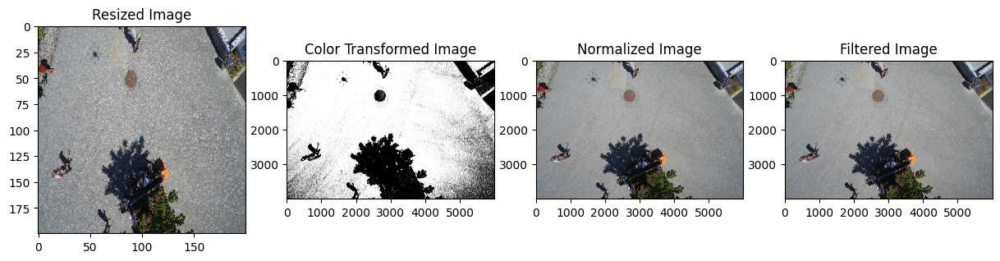

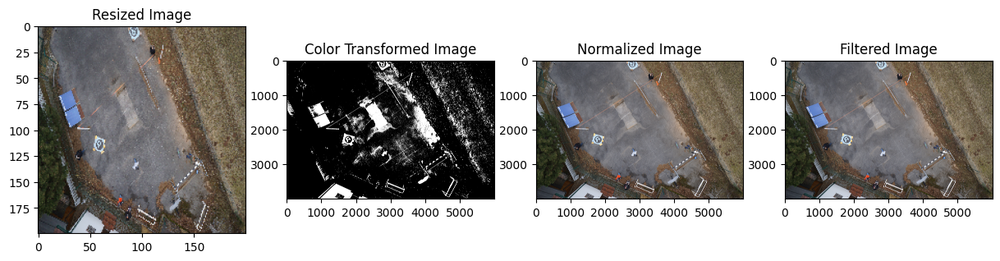

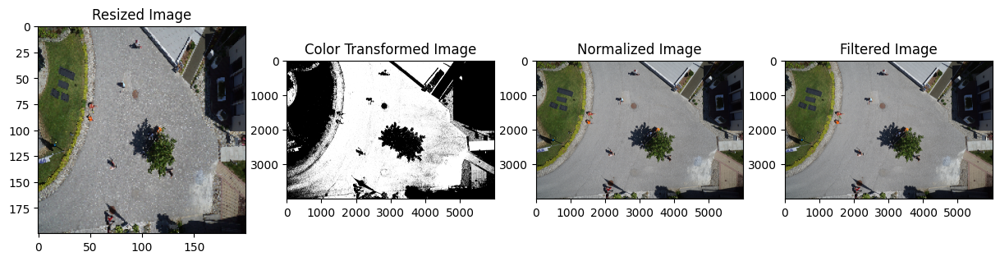

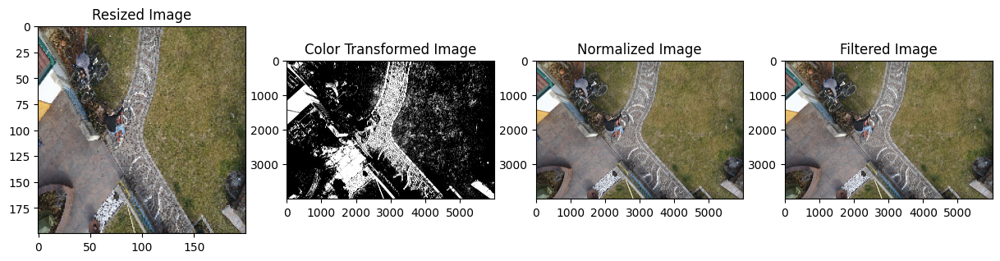

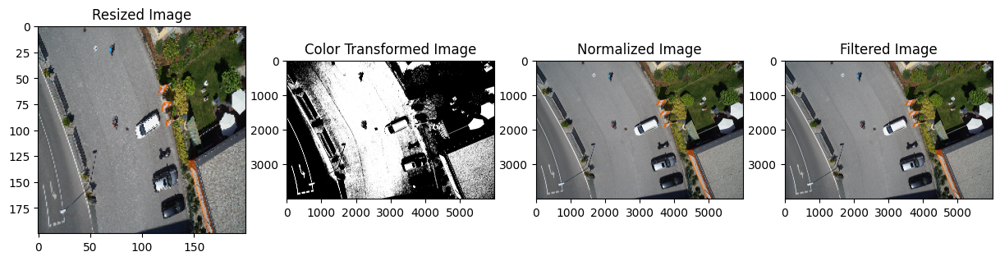

In [ ]:
# Loop through each image file, process it, and save it into the output folders
for image_file in image_files:
    # Get the file path
    input_file_path = os.path.join(input_folder, image_file)
    # Read the original image
    original_image = cv2.imread(input_file_path)
    # Resize the image
    resized_image = cv2.resize(original_image, target_size)
    output_file_path_resize = os.path.join(output_folder_resize, image_file.replace('.jpg', '_resized.png'))
    cv2.imwrite(output_file_path_resize, resized_image)
    # Color transform (e.g., grayscale conversion)
    gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
    _, color_transformed_image = cv2.threshold(gray_image, 128, 255, cv2.THRESH_BINARY)
    output_file_path_color = os.path.join(output_folder_color, image_file.replace('.jpg', '_color.png'))
    cv2.imwrite(output_file_path_color, color_transformed_image)
    # Normalize the image
    normalized_image = cv2.normalize(original_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    output_file_path_normalize = os.path.join(output_folder_normalize, image_file.replace('.jpg', '_normalize.png'))
    cv2.imwrite(output_file_path_normalize, normalized_image)
    # Apply a filter (e.g., Gaussian filter)
    filtered_image = cv2.GaussianBlur(original_image, (5, 5), 2)  # Sigma = 2
    output_file_path_filter = os.path.join(output_folder_filter, image_file.replace('.jpg', '_filter.png'))
    cv2.imwrite(output_file_path_filter, filtered_image)
     # Plotting sample images
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 4, 1)
    plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
    plt.title('Resized Image')
    plt.axis('on')
    plt.subplot(1, 4, 2)
    plt.imshow(color_transformed_image, cmap='gray')
    plt.title('Color Transformed Image')
    plt.axis('on')
    plt.subplot(1, 4, 3)
    plt.imshow(cv2.cvtColor(normalized_image.astype('uint8'), cv2.COLOR_BGR2RGB))
    plt.title('Normalized Image')
    plt.axis('on')
    plt.subplot(1, 4, 4)
    plt.imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
    plt.title('Filtered Image')
    plt.axis('on')
    plt.show()


# 02 Semantic Segmentation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import cv2 as cv
import os
import glob
import numpy as np
from matplotlib import pyplot as plt

In [ ]:
folder_path = r'E:\plant-pathology-2020-fgvc7\Input Folder'

Load images from a folder.

In [ ]:
def load_images(folder_path):
    image_files = glob.glob(os.path.join(folder_path, '*.jpg'))
    images = [cv.imread(image_path) for image_path in image_files]
    return images

In [ ]:

def semantic_segmentation(images, num_clusters=5):
    segmented_images = []
    criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 100, 0.2)
    for img in images:
        pixels = img.reshape((-1, 3))
        pixels = np.float32(pixels)
        _, labels, centers = cv.kmeans(pixels, num_clusters, None, criteria, 10, cv.KMEANS_RANDOM_CENTERS)
        centers = np.uint8(centers)
        segmented_img = centers[labels.flatten()].reshape(img.shape)
        segmented_images.append(segmented_img)
    return segmented_images


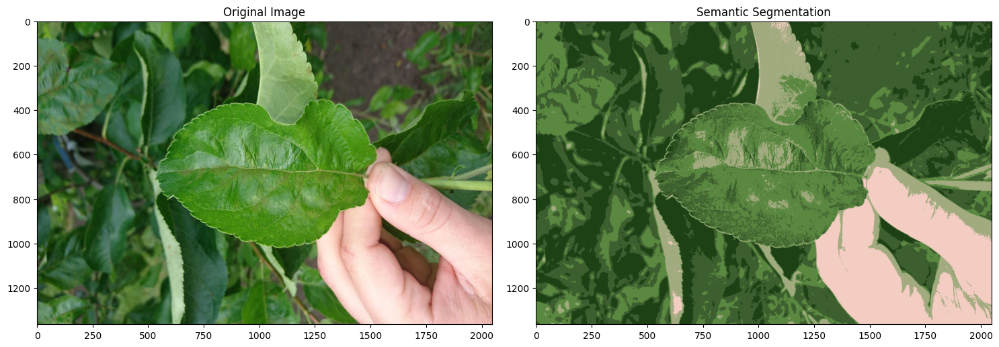

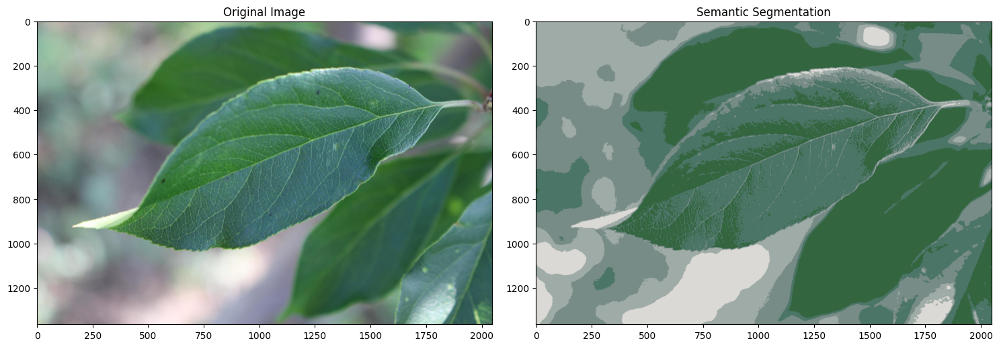

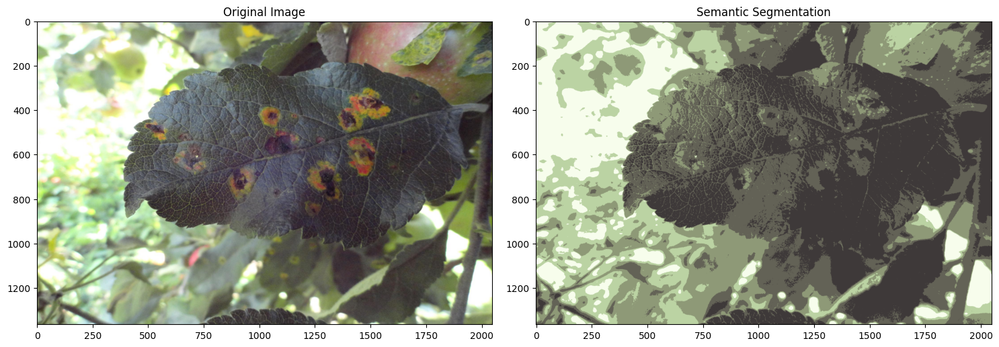

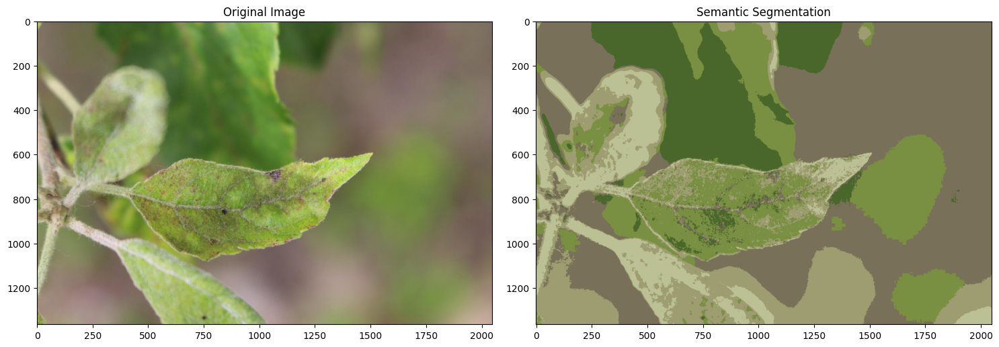

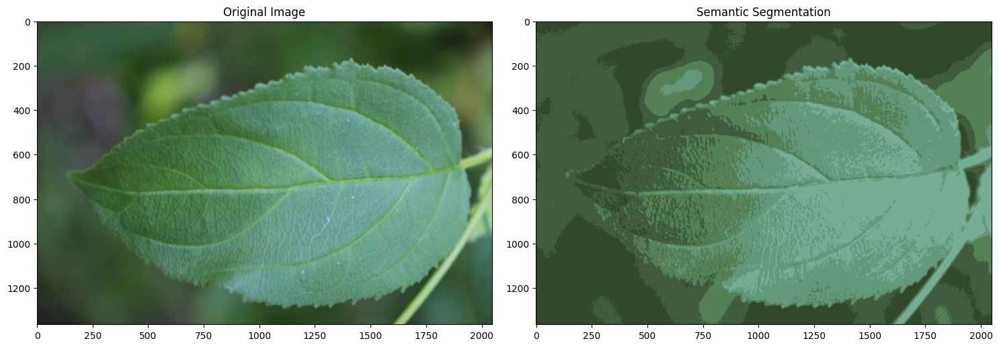

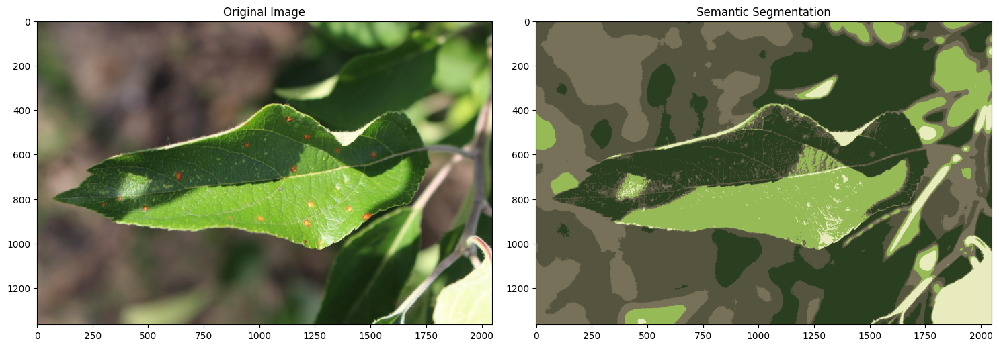

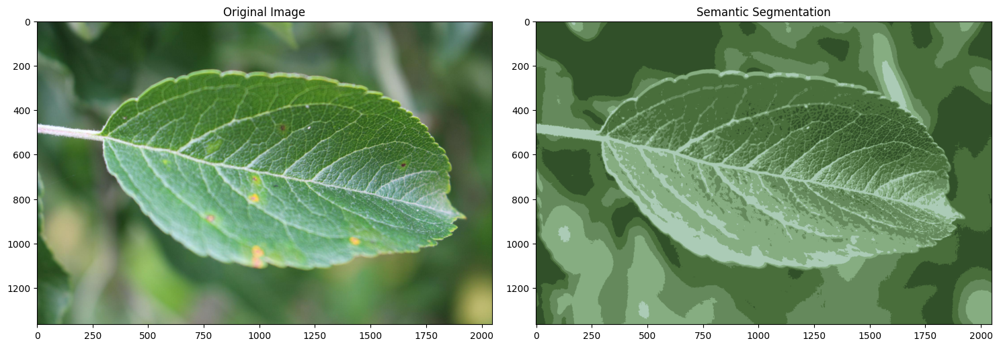

In [ ]:
# Load images
images = load_images(folder_path)
# Perform segmentation
semantic_segmented_images = semantic_segmentation(images)
number_images=len(images)
# Display results
for i in range(number_images):
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv.cvtColor(images[i], cv.COLOR_BGR2RGB))
    plt.title('Original Image')
    plt.axis('on')
    plt.subplot(1, 2, 2)
    plt.imshow(cv.cvtColor(semantic_segmented_images[i], cv.COLOR_BGR2RGB))
    plt.title('Semantic Segmentation')
    plt.axis('on')
    plt.tight_layout()
    plt.show()


# 03 Masked Area

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
# Load the image and mask
image = cv2.imread(r'C:\Users\ibnes\OneDrive\Desktop\Image.jpg')
mask = cv2.imread(r'C:\Users\ibnes\OneDrive\Desktop\Mask.jpg', cv2.IMREAD_GRAYSCALE)

In [ ]:
def compute_region_area(mask):
    # Compute the area of the region in the mask
    area = np.sum(mask / 255)  # Assuming the mask is binary (0 and 255)
    return area

In [ ]:
def label_region(image, mask):
    # Convert the mask to a binary image
    _, binary_mask = cv2.threshold(mask, 128, 255, cv2.THRESH_BINARY)
    # Find contours in the binary mask
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    # Draw contours on the image
    labeled_image = image.copy()
    cv2.drawContours(labeled_image, contours, -1, (0, 255, 0), 2)
    # Add label "Tumor" to the image
    cv2.putText(labeled_image, "Tumor", (contours[0][0][0][0], contours[0][0][0][1]), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2)
    return labeled_image

Area of the region: 899.4352941176471


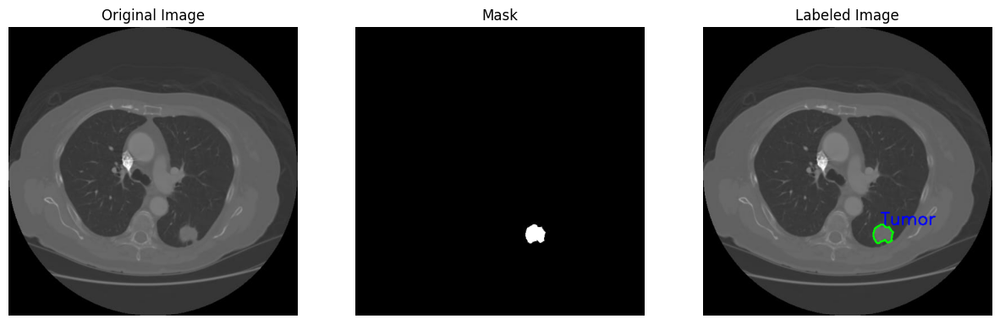

Area of the region: 899.4352941176471


In [ ]:
# Compute the area of the region in the mask
region_area = compute_region_area(mask)
print("Area of the region:", region_area)
# Label the region by overlapping the mask over the image
labeled_image = label_region(image, mask)
# Display the labeled image
# Plot the images
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(mask, cmap='gray')
plt.title('Mask')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(cv2.cvtColor(labeled_image, cv2.COLOR_BGR2RGB))
plt.title('Labeled Image')
plt.axis('off')

plt.show()

# Print the computed area
print("Area of the region:", region_area)

# 04 Intensity

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Import required Packages

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
input_folder = r'E:\Drone Dataset\dataset\semantic_drone_dataset\original_images'
output_folder_negative = r'I:\New folder\negative_images'
output_folder_log = r'I:\New folder\log_images'
output_folder_power_law = r'I:\New folder\power_law_images'
output_folder_piecewise_linear = r'I:\New folder\piecewise_linear_images'
output_folder_high_pass_filter = r'I:\New folder\high_pass_filter_images'
output_folder_low_pass_filter = r'I:\New folder\low_pass_filter_images'
output_folder_laplacian_filter = r'I:\New folder\laplacian_filter_images'
# Create output folders if they don't exist
for folder in [output_folder_negative, output_folder_log, output_folder_power_law,
               output_folder_piecewise_linear, output_folder_high_pass_filter,
               output_folder_low_pass_filter, output_folder_laplacian_filter]:
    if not os.path.exists(folder):
        os.makedirs(folder)

In [ ]:
# Function to perform negative transformation
def negative_transform(image):
    return 255 - image
# Function to perform log transformation
def log_transform(image):
    c = 255 / np.log(1 + np.max(image))
    log_transformed_image = c * (np.log(image + 1))
    return np.uint8(log_transformed_image)
# Function to perform power law transformation
def power_law_transform(image, gamma):
    return np.uint8(np.power(image / 255.0, gamma) * 255)
def piecewise_linear_transform(image):
    # Define a piecewise linear transformation lookup table
    lut = np.arange(256)
    lut[0:50] = 0  # Map pixel values 0-49 to 0
    lut[50:100] = 50  # Map pixel values 50-99 to 50
    lut[100:150] = 100  # Map pixel values 100-149 to 100
    lut[150:200] = 150  # Map pixel values 150-199 to 150
    lut[200:] = 255  # Map pixel values 200-255 to 255

    return cv2.LUT(image, lut)
# Function to apply high pass filter
def high_pass_filter(image):
    kernel_size = 3
    return cv2.filter2D(image, -1, np.array([[-1, -1, -1],
                                             [-1,  8, -1],
                                             [-1, -1, -1]]))
# Function to apply low pass filter
def low_pass_filter(image):
    kernel_size = 3
    return cv2.GaussianBlur(image, (kernel_size, kernel_size), 0)
# Function to apply Laplacian filter
def laplacian_filter(image):
    return cv2.Laplacian(image, cv2.CV_64F)


In [ ]:
# Read images from input folder
image_files = [f for f in os.listdir(input_folder) if f.endswith('.jpg')]


C:\Users\ibnes\AppData\Local\Temp\ipykernel_19332\1248186893.py:7: RuntimeWarning: divide by zero encountered in log
  log_transformed_image = c * (np.log(image + 1))
C:\Users\ibnes\AppData\Local\Temp\ipykernel_19332\1248186893.py:8: RuntimeWarning: invalid value encountered in cast
  return np.uint8(log_transformed_image)


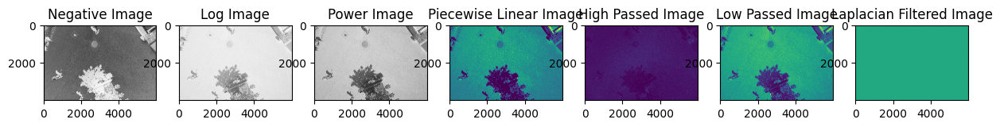

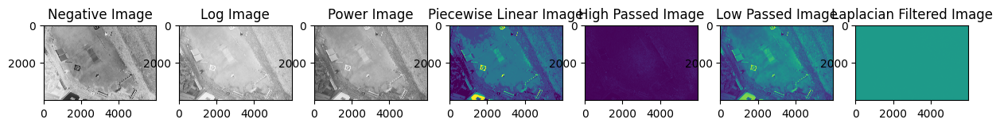

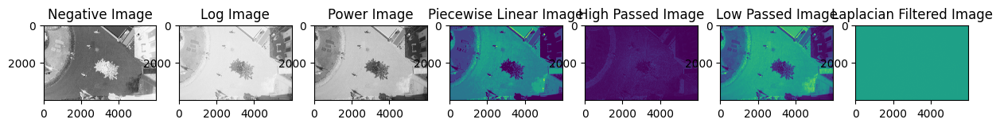

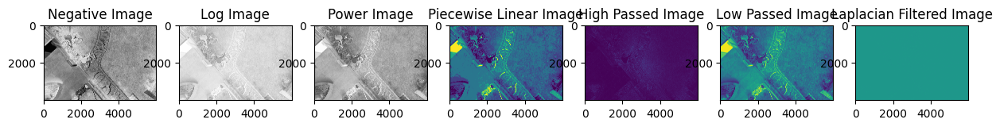

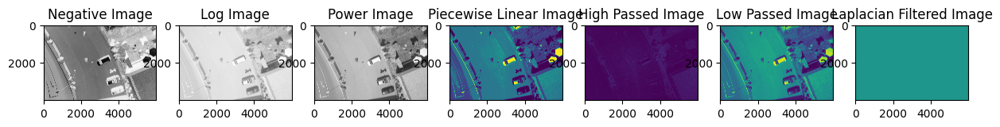

In [ ]:

# Process each image and save to respective output folders
for image_file in image_files:
    input_image = cv2.imread(os.path.join(input_folder, image_file), cv2.IMREAD_GRAYSCALE)
    # Negative transformation
    negative_image = negative_transform(input_image)
    cv2.imwrite(os.path.join(output_folder_negative, image_file), negative_image)
    # Log transformation
    log_image = log_transform(input_image)
    cv2.imwrite(os.path.join(output_folder_log, image_file), log_image)
    # Power law transformation
    power_law_image = power_law_transform(input_image, gamma=0.5)
    cv2.imwrite(os.path.join(output_folder_power_law, image_file), power_law_image)
    # Piecewise linear transformation
    piecewise_linear_image = piecewise_linear_transform(input_image)
    cv2.imwrite(os.path.join(output_folder_piecewise_linear, image_file), piecewise_linear_image)
    # High pass filter
    high_pass_filtered_image = high_pass_filter(input_image)
    cv2.imwrite(os.path.join(output_folder_high_pass_filter, image_file), high_pass_filtered_image)
    # Low pass filter
    low_pass_filtered_image = low_pass_filter(input_image)
    cv2.imwrite(os.path.join(output_folder_low_pass_filter, image_file), low_pass_filtered_image)
    # Laplacian filter
    laplacian_filtered_image = laplacian_filter(input_image)
    cv2.imwrite(os.path.join(output_folder_laplacian_filter, image_file), laplacian_filtered_image)
    
     # Plotting sample images
    plt.figure(figsize=(15, 5))
    plt.subplot(1, 7, 1)
    plt.imshow(cv2.cvtColor(negative_image, cv2.COLOR_BGR2RGB))
    plt.title('Negative Image')
    plt.axis('on')
    plt.subplot(1, 7, 2)
    plt.imshow(log_image, cmap='gray')
    plt.title('Log Image')
    plt.axis('on')
    plt.subplot(1, 7, 3)
    plt.imshow(cv2.cvtColor(power_law_image.astype('uint8'), cv2.COLOR_BGR2RGB))
    plt.title('Power Image')
    plt.axis('on')
    plt.subplot(1, 7, 4)
    plt.imshow(piecewise_linear_image)
    plt.title('Piecewise Linear Image')
    plt.axis('on')
    plt.subplot(1, 7, 5)
    plt.imshow(high_pass_filtered_image)
    plt.title('High Passed Image')
    plt.axis('on')
    plt.subplot(1, 7, 6)
    plt.imshow(low_pass_filtered_image)
    plt.title('Low Passed Image')
    plt.axis('on')
    plt.subplot(1, 7, 7)
    plt.imshow(laplacian_filtered_image)
    plt.title('Laplacian Filtered Image')
    plt.axis('on')
    plt.show()



# 05 Edge Detection

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
input_folder = r'E:\Edge'
output_folder_canny = r'E:\Edge\canny_output'
output_folder_prewitt = r'E:\Edge\prewitt_output'
output_folder_sobel = r'E:\Edge\sobel_output'

# Create output folders if they don't exist
for folder in [output_folder_canny, output_folder_prewitt, output_folder_sobel]:
    if not os.path.exists(folder):
        os.makedirs(folder)


In [ ]:
def canny_edge_detection(image):
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply Canny edge detection
    edges = cv2.Canny(gray_image, 100, 200)
    return edges

def prewitt_edge_detection(image):
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply Prewitt edge detection
    kernel_x = np.array([[1, 0, -1],
                         [1, 0, -1],
                         [1, 0, -1]])
    kernel_y = np.array([[1, 1, 1],
                         [0, 0, 0],
                         [-1, -1, -1]])
    edges_x = cv2.filter2D(gray_image, -1, kernel_x)
    edges_y = cv2.filter2D(gray_image, -1, kernel_y)
    edges = np.sqrt(np.square(edges_x) + np.square(edges_y))
    
    return edges.astype(np.uint8)

def sobel_edge_detection(image):
    # Convert the image to grayscale
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    # Apply Sobel edge detection
    sobel_x = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize=3)
    sobel_y = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize=3)
    edges = np.sqrt(np.square(sobel_x) + np.square(sobel_y))
    
    return edges.astype(np.uint8)

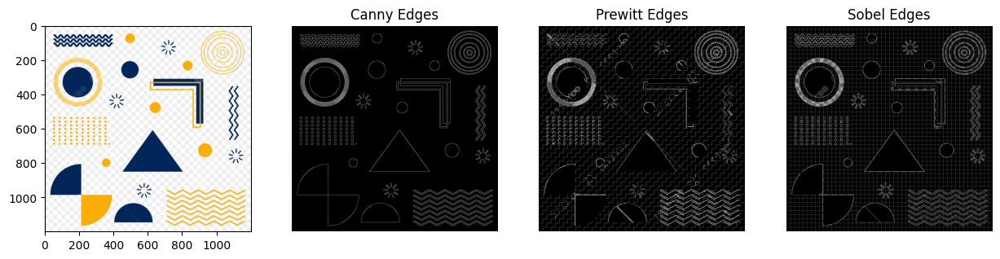

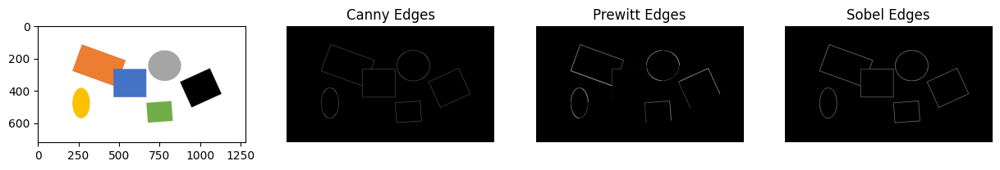

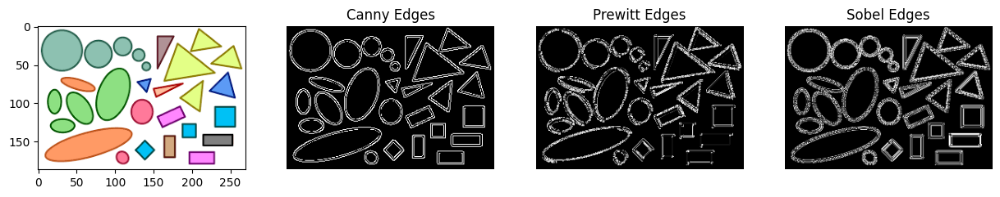

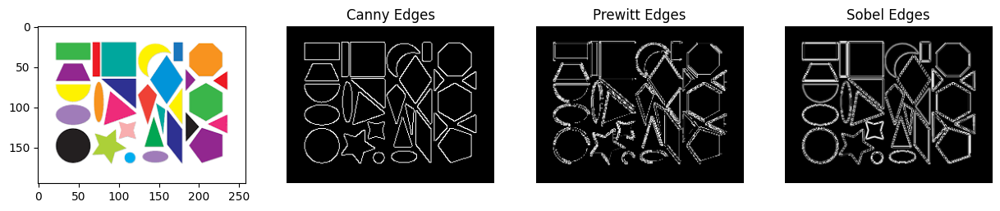

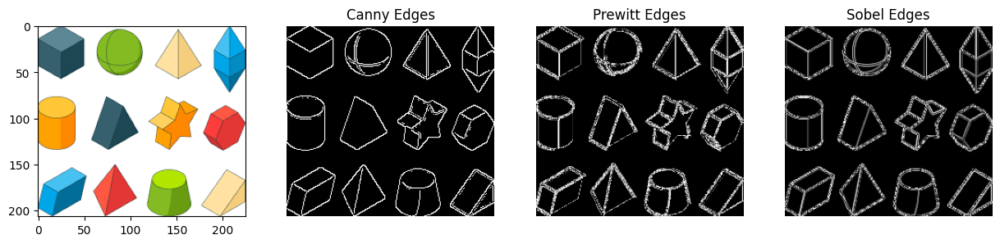

In [ ]:
# Process images
for filename in os.listdir(input_folder):
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # Read the image
        image_path = os.path.join(input_folder, filename)
        image = cv2.imread(image_path)
        # Apply edge detection algorithms
        canny_edges = canny_edge_detection(image)
        prewitt_edges = prewitt_edge_detection(image)
        sobel_edges = sobel_edge_detection(image)
        # Save output images
        cv2.imwrite(os.path.join(output_folder_canny, filename), canny_edges)
        cv2.imwrite(os.path.join(output_folder_prewitt, filename), prewitt_edges)
        cv2.imwrite(os.path.join(output_folder_sobel, filename), sobel_edges)
        # Plot images
        plt.figure(figsize=(15, 5))
        # Plot original image
        plt.subplot(1, 4, 1)
        plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
        # Plot Canny edges
        plt.subplot(1, 4, 2)
        plt.imshow(canny_edges, cmap='gray')
        plt.title('Canny Edges');plt.axis('off')
        # Plot Prewitt edges
        plt.subplot(1, 4, 3)
        plt.imshow(prewitt_edges, cmap='gray')
        plt.title('Prewitt Edges');plt.axis('off')
        # Plot Sobel edges
        plt.subplot(1, 4, 4)
        plt.imshow(sobel_edges, cmap='gray')
        plt.title('Sobel Edges');plt.axis('off')
        plt.show()


# 06 Under Sampling Bit Resolution

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Import packages

In [ ]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt
import soundfile as sf
from scipy.io import wavfile
from IPython.display import Audio, display

In [ ]:
def plot_waveform_and_spectrogram(signal, sr, title):
    # Calculate time array
    time = np.arange(len(signal)) / sr
    # Plot the waveform
    plt.figure(figsize=(12, 6))
    plt.subplot(2, 1, 1)
    plt.plot(time, signal, color='r')
    plt.title('Waveform of the speech signal - ' + title)
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.grid()
    # Plot the spectrogram
    plt.subplot(2, 1, 2)
    spectrogram = librosa.feature.melspectrogram(y=signal, sr=sr)
    librosa.display.specshow(librosa.power_to_db(spectrogram, ref=np.max), sr=sr, x_axis='time', y_axis='mel')
    plt.colorbar(format='%+2.0f dB')
    plt.title('Mel Spectrogram - ' + title)
    plt.xlabel('Time (s)')
    plt.ylabel('Frequency (Hz)')
    plt.tight_layout()
    plt.show()

Original Sampling Frequency: 48000
Original Bit Resolution: float32
Bit Resolution Technique: PCM_16


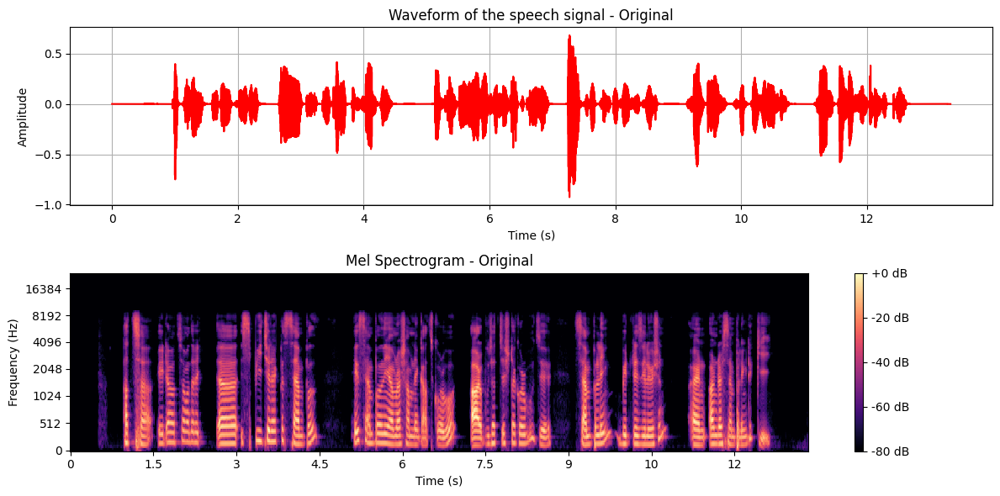

In [ ]:
# Example usage:
file_path = r'C:\Users\ibnes\OneDrive\Documents\Sound Recordings\Sampling.wav'
# Load the audio file with Librosa
signal, sr = librosa.load(file_path, sr=None)
bit_resolution = sf.info(file_path).subtype
# Identify sampling frequency and bit resolution
print('Original Sampling Frequency:', sr)
print('Original Bit Resolution:', signal.dtype)
print('Bit Resolution Technique:', bit_resolution)
# Plot waveform and spectrogram of the original signal
plot_waveform_and_spectrogram(signal, sr, 'Original')
# Play the original signal
display(Audio(signal, rate=sr))

Resampled Sampling Frequency: 8000
Resampled Bit Resolution: float32


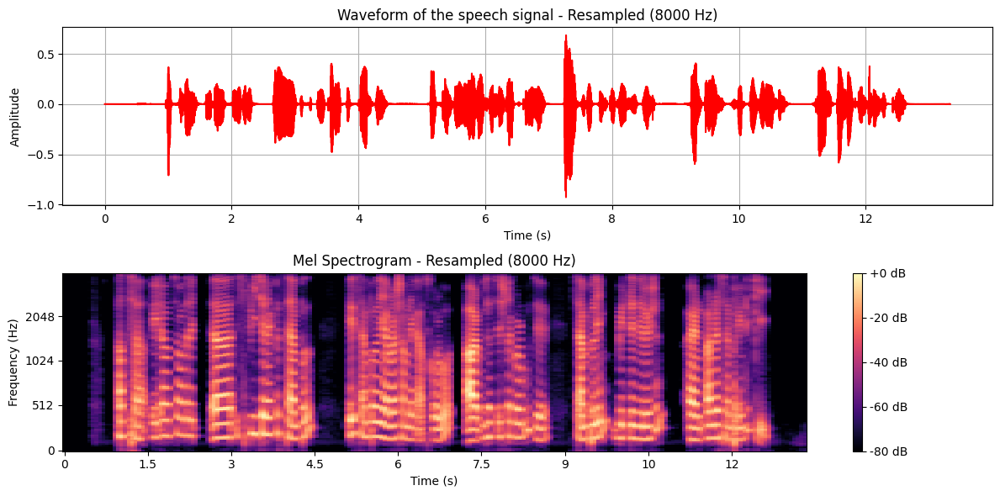

In [ ]:
TargetSampling1 = 8000
signal_resampled = librosa.resample(signal, orig_sr=sr, target_sr=TargetSampling1)
# Identify sampling frequency and bit resolution of the resampled signal
print('Resampled Sampling Frequency:', TargetSampling1)
print('Resampled Bit Resolution:', signal_resampled.dtype)
# Save the resampled signal
wavfile.write('speech_signal_8000Hz.wav', TargetSampling1, (signal_resampled * 32767).astype(np.int16))
# Plot waveform and spectrogram of the resampled signal
plot_waveform_and_spectrogram(signal_resampled, TargetSampling1, 'Resampled (8000 Hz)')
# Play the resampled signal
display(Audio(signal_resampled, rate=TargetSampling1))


Resampled Sampling Frequency: 8000
Resampled Bit Resolution: int16


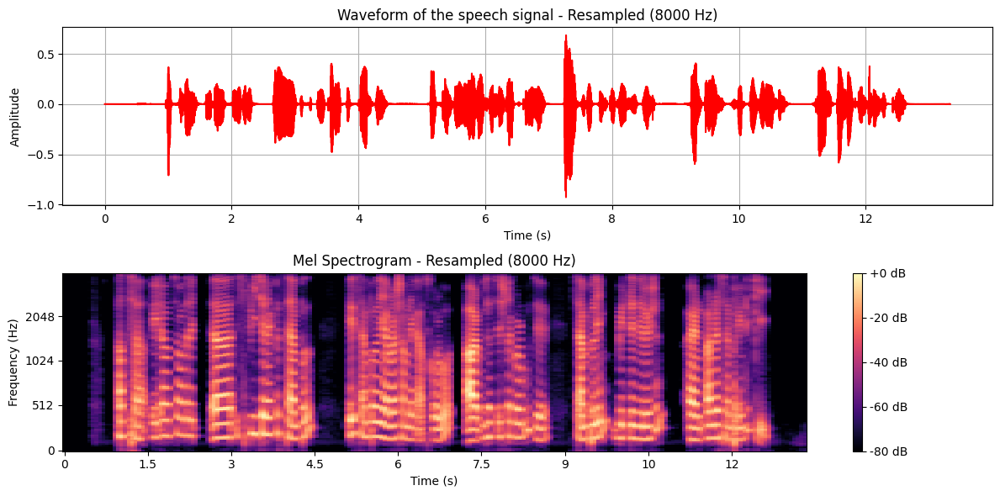

In [ ]:
signal_resampled_16bit = (signal_resampled * 32767).astype(np.int16)

# Identify sampling frequency and bit resolution of the resampled signal
print('Resampled Sampling Frequency:', TargetSampling1)
print('Resampled Bit Resolution:', signal_resampled_16bit.dtype)

# Save the resampled signal with reduced bit resolution
wavfile.write('speech_signal_8000Hz_16bit.wav', TargetSampling1, signal_resampled_16bit)

# Plot waveform and spectrogram of the resampled signal
plot_waveform_and_spectrogram(signal_resampled, TargetSampling1, 'Resampled (8000 Hz)')

# Play the resampled signal
display(Audio(signal_resampled, rate=TargetSampling1))

# 07 Voice Unvoice

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import numpy as np
import librosa
import librosa.display
import matplotlib.pyplot as plt

In [ ]:
# Read the audio file
y, sr = librosa.load(r'C:\Users\ibnes\OneDrive\Documents\Sound Recordings\Sampling.wav')

# Define frame size and overlap (in samples)
frame_size = 256
overlap = 128
# Calculate number of frames
num_frames = len(y) // (frame_size - overlap)

In [ ]:
# Initialize variables
voiced_frames = []
unvoiced_frames = []
silence_frames = []
# Iterate through each frame
for i in range(num_frames):
    # Extract current frame
    start = (i) * (frame_size - overlap)
    end = start + frame_size
    frame = y[start:end]
    # Calculate energy of the frame
    energy = np.sum(np.abs(frame) ** 2)
    # Calculate zero-crossing rate (ZCR)
    zcr = np.sum(np.diff(np.sign(frame)) != 0)
    # Thresholds for voiced, unvoiced, and silence detection
    voiced_threshold = 0.01 * np.max(energy)  # adjust threshold based on your audio
    unvoiced_threshold = 0.001 * np.max(energy)  # adjust threshold based on your audio
    silence_threshold = 0.0001 * np.max(energy)  # adjust threshold based on your audio
    # Identify frame type based on energy and ZCR
    if energy > voiced_threshold and zcr > 10:  # adjust values for voiced detection
        voiced_frames.append(i)
    elif energy > unvoiced_threshold and zcr < 10:  # adjust values for unvoiced detection
        unvoiced_frames.append(i)
    else:
        silence_frames.append(i)

# Calculate time axis for plotting
time_axis = np.arange(0, len(y)) / sr


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


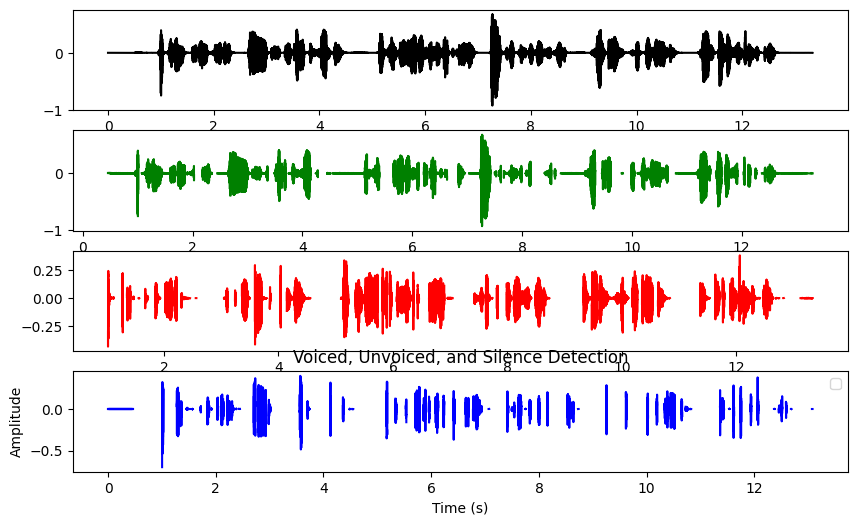

In [ ]:
# Plot original signal
plt.figure(figsize=(10, 6))
plt.subplot(4, 1, 1)
plt.plot(time_axis, y, 'k', label='Original Signal')  # black for original signal

# Plot voiced segments
for i in voiced_frames:
    start_idx = i * (frame_size - overlap)
    end_idx = start_idx + frame_size
    plt.subplot(4, 1, 2)
    
    plt.plot(time_axis[start_idx:end_idx], y[start_idx:end_idx], 'g')

# Plot unvoiced segments
for i in unvoiced_frames:
    start_idx = i * (frame_size - overlap)
    end_idx = start_idx + frame_size
    plt.subplot(4, 1, 3)
    plt.plot(time_axis[start_idx:end_idx], y[start_idx:end_idx], 'r')

# Plot silence segments
for i in silence_frames:
    start_idx = i * (frame_size - overlap)
    end_idx = start_idx + frame_size
    plt.subplot(4, 1, 4)
    plt.plot(time_axis[start_idx:end_idx], y[start_idx:end_idx], 'b')

plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Voiced, Unvoiced, and Silence Detection')
plt.legend()
plt.show()    


# 08 Zero Crossing

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf  # For loading audio files
import numpy as np
import librosa
from IPython.display import Audio, display

# Function to compute zero crossing rate

In [ ]:
def zero_crossing_rate(signal):
    zcr = np.mean(np.abs(np.diff(np.sign(signal))) / 2)
    return zcr

# Function to apply window function
def apply_window(signal, window_type):
    window = np.hamming(len(signal))
    if window_type == 'rectangular':
        window = np.ones(len(signal))
    elif window_type == 'hamming':
        window = np.hamming(len(signal))
    elif window_type == 'hanning':
        window = np.hanning(len(signal))
    return signal * window


# Load speech signal

In [ ]:
file_path = r'C:\Users\ibnes\OneDrive\Documents\Sound Recordings\Sampling.wav'   # Change this to your audio file path
signal, sampling_rate = sf.read(file_path)
signal1, sr = librosa.load(file_path, sr=None)
display(Audio(signal1, rate=sr))

# Convert to mono if stereo
if len(signal.shape) > 1:
    signal = signal.mean(axis=1)

# Normalize the signal
signal = signal / np.max(np.abs(signal))

# Compute ZCR for the original signal
zcr_original = zero_crossing_rate(signal)

In [ ]:
cut_signal = signal1[int(sr * 2.5):int(sr * 2.53)]
frame_length = int(sr * 0.03)  # 30 ms frame length
hop_length = 512

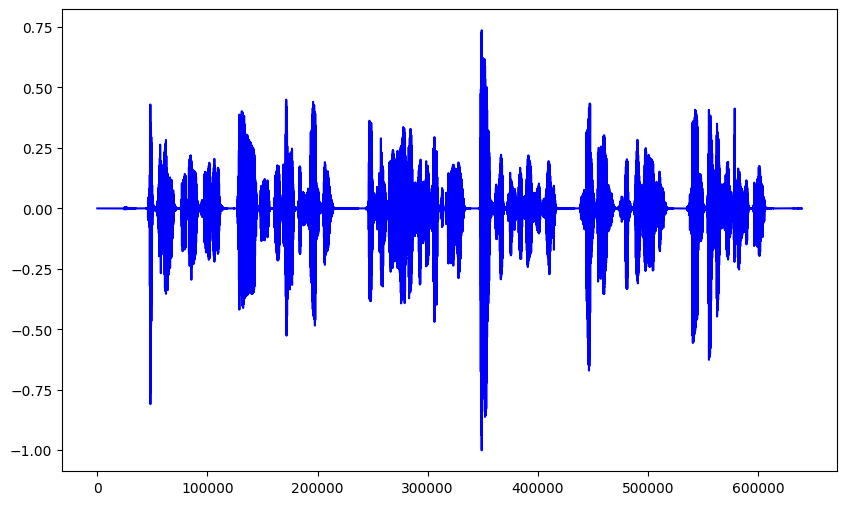

In [ ]:
# Apply different window functions and compute ZCR
window_types = ['rectangular', 'hamming', 'hanning','blackman']
zcr_values = []
plt.figure(figsize=(10, 6))
plt.plot(signal, label='Original Signal', color='blue')

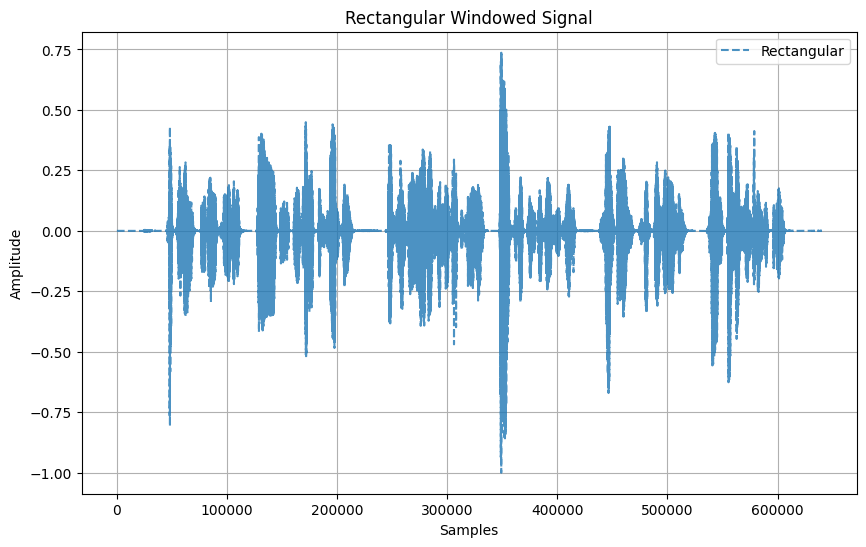

Rectangular Window ZCR: 0.049267862696709644


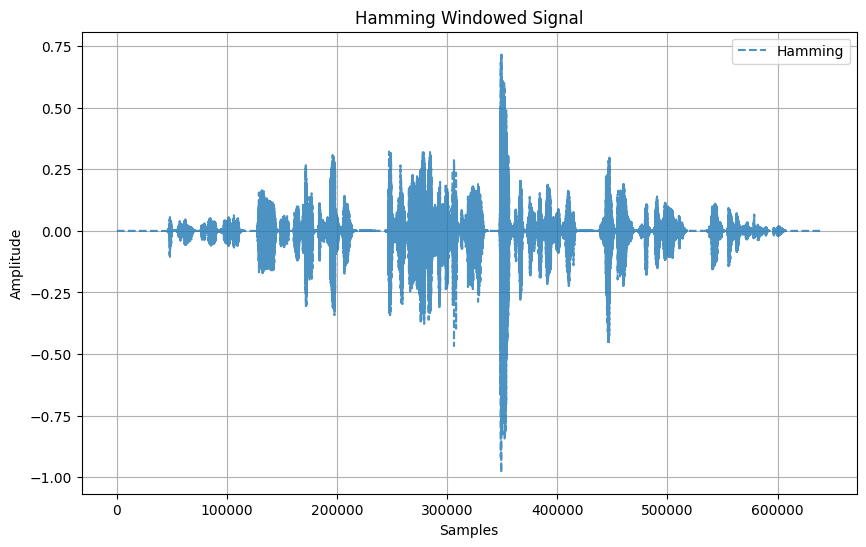

Hamming Window ZCR: 0.049267862696709644


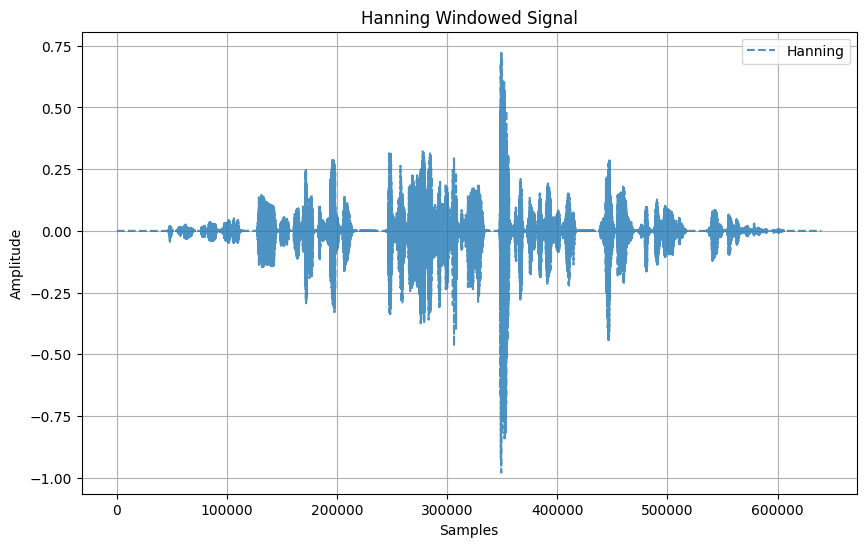

Hanning Window ZCR: 0.049268644143292295


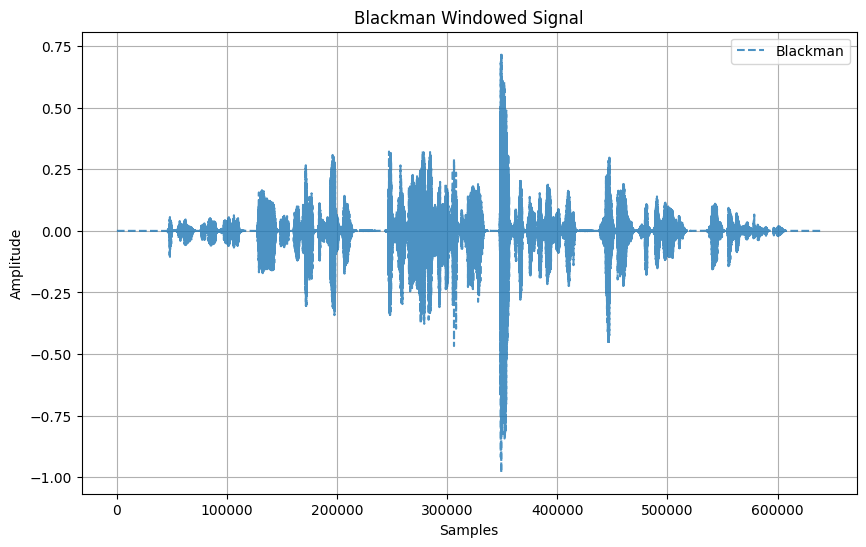

Blackman Window ZCR: 0.049267862696709644


Original ZCR: 0.049267862696709644


In [ ]:
for window_type in window_types:
    windowed_signal = apply_window(signal, window_type)
    zcr = zero_crossing_rate(windowed_signal)
    zcr_values.append(zcr)
    plt.figure(figsize=(10, 6))
    plt.plot(windowed_signal, label=window_type.capitalize(), linestyle='--', alpha=0.8)
    plt.title(f'{window_type.capitalize()} Windowed Signal')
    plt.xlabel('Samples')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.grid(True)
    plt.show()
    print(f"{window_type.capitalize()} Window ZCR:", zcr)
    display(Audio(windowed_signal, rate=sampling_rate))

# Print original ZCR
print("Original ZCR:", zcr_original)

# 09 Auto Correlation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf  # For loading audio files
import librosa
import librosa.display


# Function to compute short-term autocorrelation

In [ ]:
def short_term_autocorrelation(signal, window_size):
    autocorrelation = np.correlate(signal, signal, mode='full')
    autocorrelation = autocorrelation[len(autocorrelation)//2:]
    autocorrelation = autocorrelation[:window_size]
    return autocorrelation

# Function to classify voiced and unvoiced segments using autocorrelation

In [ ]:
def classify_voiced_unvoiced(signal, sampling_rate):
    window_length = len(signal)
    autocorrelation = short_term_autocorrelation(signal, window_length)
    peak_index = np.argmax(autocorrelation)
    fundamental_frequency = sampling_rate / peak_index
    threshold = 100  # Adjust this threshold as needed
    if fundamental_frequency > threshold:
        return 'voiced', fundamental_frequency
    else:
        return 'unvoiced', fundamental_frequency

# Load speech signal

In [ ]:
file_path = r'C:\Users\ibnes\OneDrive\Documents\Sound Recordings\Voice.wav'  # Change this to your audio file path
signal, sampling_rate = sf.read(file_path)

# Convert to mono if stereo # Normalize the signal # Set window size for short-term autocorrelation 


In [ ]:

if len(signal.shape) > 1:
    signal = signal.mean(axis=1)


signal = signal / np.max(np.abs(signal))

window_size = 500

# Classify voiced and unvoiced segments

In [ ]:
voiced_segments = []
unvoiced_segments = []
segment_lengths = []
i = 0
while i < len(signal):
    segment = signal[i:i+window_size]
    segment_type, _ = classify_voiced_unvoiced(segment, sampling_rate)
    if segment_type == 'voiced':
        voiced_segments.append(segment)
    else:
        unvoiced_segments.append(segment)
    segment_lengths.append(len(segment))
    i += window_size

C:\Users\ibnes\AppData\Local\Temp\ipykernel_21492\3259571221.py:5: RuntimeWarning: divide by zero encountered in scalar divide
  fundamental_frequency = sampling_rate / peak_index


# Flatten the segments into single arrays

In [ ]:
voiced_signal = np.concatenate(voiced_segments)
unvoiced_signal = np.zeros(len(signal)) if len(unvoiced_segments) == 0 else np.concatenate(unvoiced_segments)


# Compute short-term autocorrelation for the original, voiced, and unvoiced signals

In [ ]:

autocorrelation_original = short_term_autocorrelation(signal, window_size)
autocorrelation_voiced = short_term_autocorrelation(voiced_signal, window_size)
autocorrelation_unvoiced = short_term_autocorrelation(unvoiced_signal, window_size)

# Plotting

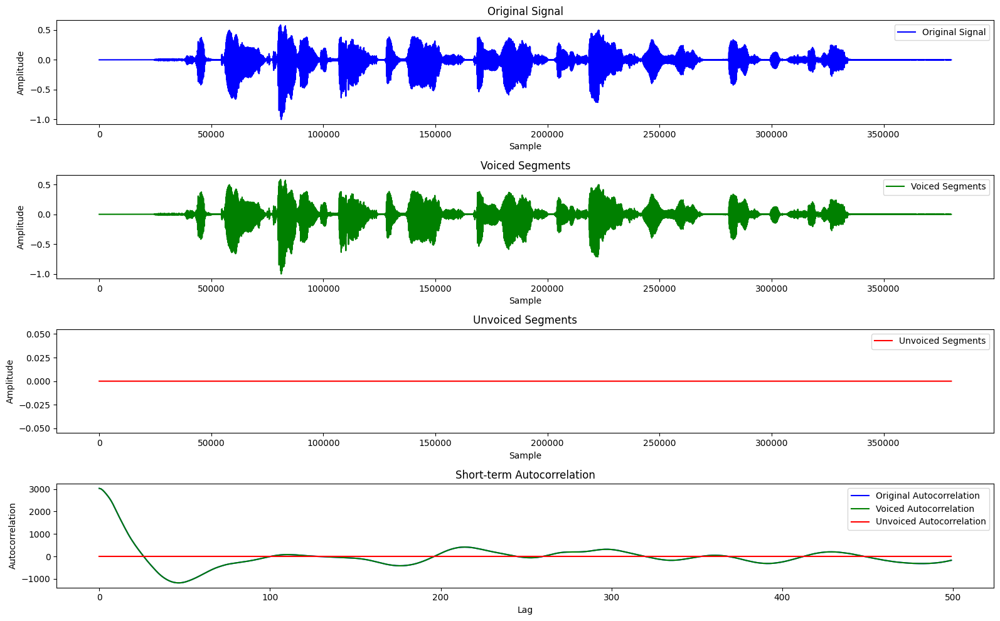

In [ ]:
plt.figure(figsize=(16, 10))

# Plot original signal
plt.subplot(4, 1, 1)
plt.plot(signal, label='Original Signal', color='blue')
plt.title('Original Signal')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()

# Plot voiced segments
plt.subplot(4, 1, 2)
plt.plot(voiced_signal, label='Voiced Segments', color='green')
plt.title('Voiced Segments')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()

# Plot unvoiced segments
plt.subplot(4, 1, 3)
plt.plot(unvoiced_signal, label='Unvoiced Segments', color='red')
plt.title('Unvoiced Segments')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.legend()

# Plot short-term autocorrelation
plt.subplot(4, 1, 4)
plt.plot(autocorrelation_original, label='Original Autocorrelation', color='blue')
plt.plot(autocorrelation_voiced, label='Voiced Autocorrelation', color='green')
plt.plot(autocorrelation_unvoiced, label='Unvoiced Autocorrelation', color='red')
plt.title('Short-term Autocorrelation')
plt.xlabel('Lag')
plt.ylabel('Autocorrelation')
plt.legend()

plt.tight_layout()
plt.show()


# 10 Pitch Estimation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# Importing the Required Packages

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf  # For loading audio files
from scipy.signal import find_peaks

# Function to compute autocorrelation

In [ ]:
def autocorrelation(signal):
    corr = np.correlate(signal, signal, mode='full')
    return corr[len(corr)//2:]

# Function to estimate pitch using autocorrelation

In [ ]:
def estimate_pitch(signal, fs):
    # Calculate autocorrelation
    autocorr_values = autocorrelation(signal)
    
    # Keep only positive values
    autocorr_values = autocorr_values[:len(autocorr_values)//2]
    
    # Find peaks in autocorrelation function
    peaks, _ = find_peaks(autocorr_values)
    
    # Remove peaks corresponding to very low frequencies
    peaks = peaks[peaks > fs / 500] 
    
    # Compute pitch period
    pitch_period = np.diff(peaks)[0] / fs
    
    # Convert pitch period to pitch frequency
    pitch_freq = 1 / pitch_period
    
    return pitch_freq, autocorr_values, peaks

# Load speech signal

In [ ]:
file_path = r'C:\Users\ibnes\OneDrive\Documents\Sound Recordings\Voice.wav' # Change this to your audio file path

In [ ]:
signal, sampling_rate = sf.read(file_path)
# Convert to mono if stereo
if len(signal.shape) > 1:
    signal = signal.mean(axis=1)
# Normalize the signal
signal = signal / np.max(np.abs(signal))
# Estimate pitch
pitch_freq, autocorr_values, peaks = estimate_pitch(signal, sampling_rate)

print("Estimated Pitch Frequency:", pitch_freq, "Hz")

Estimated Pitch Frequency: 461.53846153846155 Hz


# Plotting The Figures


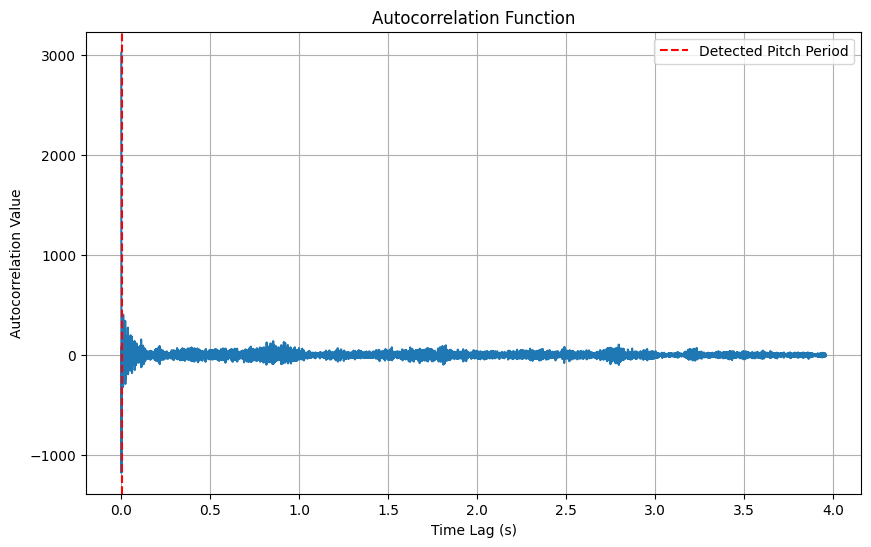

In [ ]:
plt.figure(figsize=(10, 6))
plt.plot(np.arange(len(autocorr_values)) / sampling_rate, autocorr_values)
plt.title('Autocorrelation Function')
plt.xlabel('Time Lag (s)')
plt.ylabel('Autocorrelation Value')
plt.grid(True)
plt.axvline(x=peaks[0] / sampling_rate, color='r', linestyle='--', label='Detected Pitch Period')
plt.legend()
plt.show()